In [1]:
# Uninstall TensorFlow, TensorFlow Hub, Keras, and other dependencies
!pip uninstall -y tensorflow tensorflow-hub keras


Found existing installation: tensorflow 2.17.1
Uninstalling tensorflow-2.17.1:
  Successfully uninstalled tensorflow-2.17.1
Found existing installation: tensorflow-hub 0.16.1
Uninstalling tensorflow-hub-0.16.1:
  Successfully uninstalled tensorflow-hub-0.16.1
Found existing installation: keras 3.5.0
Uninstalling keras-3.5.0:
  Successfully uninstalled keras-3.5.0


In [ ]:
# Reinstall TensorFlow (using a specific version if needed)
!pip install tensorflow==2.12.0  # Adjust version as needed

# Reinstall TensorFlow Hub (ensure it's compatible with TensorFlow)
!pip install tensorflow-hub==0.13.0  # Adjust version if needed

# Reinstall Keras (if needed separately, although it's included in TensorFlow 2.x)
!pip install keras==2.11.0  # Adjust version if needed


  Using cached keras-2.11.0-py2.py3-none-any.whl.metadata (1.4 kB)
Using cached keras-2.11.0-py2.py3-none-any.whl (1.7 MB)
  Attempting uninstall: keras
    Found existing installation: keras 2.12.0
    Uninstalling keras-2.12.0:
      Successfully uninstalled keras-2.12.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.12.0 requires keras<2.13,>=2.12.0, but you have keras 2.11.0 which is incompatible.
tf-keras 2.17.0 requires tensorflow<2.18,>=2.17, but you have tensorflow 2.12.0 which is incompatible.


In [1]:
!pip install protobuf==3.20.3

In [2]:
import numpy as np
import cv2

import PIL.Image as Image
import os

import matplotlib.pylab as plt

import tensorflow as tf
import tensorflow_hub as hub

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential

In [3]:
IMAGE_SHAPE = (224, 224)

classifier = tf.keras.Sequential([
    hub.KerasLayer("https://tfhub.dev/google/tf2-preview/mobilenet_v2/classification/4", input_shape=IMAGE_SHAPE+(3,))
])

In [5]:
!wget https://storage.googleapis.com/download.tensorflow.org/data/ImageNetLabels.txt


--2024-12-09 16:21:52--  https://storage.googleapis.com/download.tensorflow.org/data/ImageNetLabels.txt
Resolving storage.googleapis.com (storage.googleapis.com)... 142.251.175.207, 142.251.10.207, 142.251.12.207, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|142.251.175.207|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 10484 (10K) [text/plain]
Saving to: ‘ImageNetLabels.txt’

ImageNetLabels.txt  100%[===================>]  10.24K  --.-KB/s    in 0s      

2024-12-09 16:21:52 (35.3 MB/s) - ‘ImageNetLabels.txt’ saved [10484/10484]



In [6]:
image_labels = []
with open("ImageNetLabels.txt", "r") as f:
    image_labels = f.read().splitlines()
image_labels[:5]

['background', 'tench', 'goldfish', 'great white shark', 'tiger shark']

In [8]:
%%capture
!sudo apt -qq install git-lfs
!git config --global credential.helper store

In [10]:
#Mount your google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [11]:
!ls -al "/content/drive/MyDrive/yoga-poses-dataset.zip"

-rw------- 1 root root 680902636 Dec  7 14:49 /content/drive/MyDrive/yoga-poses-dataset.zip


In [12]:
!unzip "/content/drive/MyDrive/yoga-poses-dataset" -d /tmp/yogaimg

Archive:  /content/drive/MyDrive/yoga-poses-dataset.zip
   creating: /tmp/yogaimg/yoga-poses-dataset/
  inflating: /tmp/yogaimg/yoga-poses-dataset/1.archive  
   creating: /tmp/yogaimg/yoga-poses-dataset/DATASET/
   creating: /tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/
   creating: /tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/downdog/
  inflating: /tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/downdog/00000000.jpg  
  inflating: /tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/downdog/00000001.JPG  
  inflating: /tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/downdog/00000002.jpg  
  inflating: /tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/downdog/00000003.jpg  
  inflating: /tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/downdog/00000004.jpg  
  inflating: /tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/downdog/00000005.jpg  
  inflating: /tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/downdog/00000006.jpg  
  inflating: /tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/downdog/00000007.jpg  
  i

In [ ]:
data_dir="/tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN"

In [ ]:
import pathlib
data_dir = pathlib.Path(data_dir)
data_dir

PosixPath('/tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN')

In [ ]:
list(data_dir.glob('*/*.jpg'))[:5]

[PosixPath('/tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/warrior2/flipped_00000012.jpg'),
 PosixPath('/tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/warrior2/noisy_00000370.jpg'),
 PosixPath('/tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/warrior2/00000021.jpg'),
 PosixPath('/tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/warrior2/noisy_00000062.jpg'),
 PosixPath('/tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/warrior2/00000269.jpg')]

In [ ]:
image_count = len(list(data_dir.glob('*/*.jpg')))
print(image_count)

1941


In [ ]:
TT = list(data_dir.glob('tree/*'))
TT[:5]

[PosixPath('/tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/tree/00000185.jpg'),
 PosixPath('/tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/tree/flipped_00000019.png'),
 PosixPath('/tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/tree/00000092.jpg'),
 PosixPath('/tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/tree/00000103.jpg'),
 PosixPath('/tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/tree/noisy_00000071.jpg')]

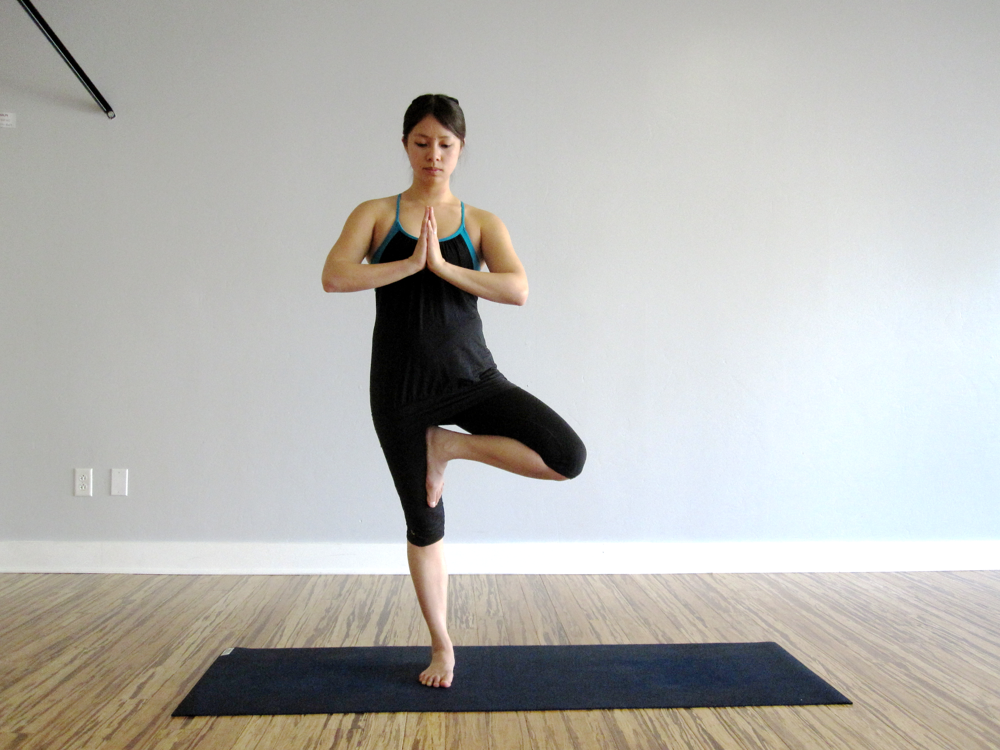

In [ ]:
import PIL
PIL.Image.open(str(TT[1]))

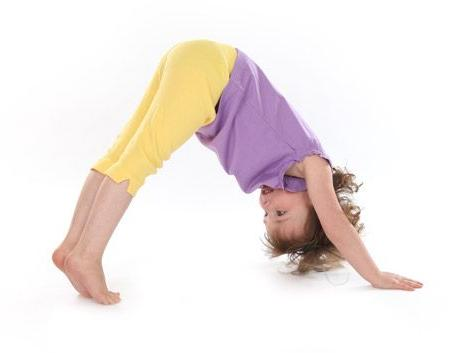

In [ ]:
DD = list(data_dir.glob('downdog/*'))
PIL.Image.open(str(DD[0]))

In [ ]:
yoga_poses_img_dict = {
    'downdog': list(data_dir.glob('downdog/*')),
    'goddess': list(data_dir.glob('goddess/*')),
    'plank': list(data_dir.glob('plank/*')),
    'tree': list(data_dir.glob('tree/*')),
    'warror2': list(data_dir.glob('warrior2/*')),
}

In [ ]:
yoga_poses_lab_dict = {
    'downdog': 0,
    'goddess': 1,
    'plank':   2,
    'tree':    3,
    'warror2': 4,
}

In [ ]:
yoga_poses_img_dict['tree'][:5]

[PosixPath('/tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/tree/00000185.jpg'),
 PosixPath('/tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/tree/flipped_00000019.png'),
 PosixPath('/tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/tree/00000092.jpg'),
 PosixPath('/tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/tree/00000103.jpg'),
 PosixPath('/tmp/yogaimg/yoga-poses-dataset/DATASET/TRAIN/tree/noisy_00000071.jpg')]

In [ ]:
str(yoga_poses_img_dict['tree'][0])
img = cv2.imread(str(yoga_poses_img_dict['tree'][0]))
img.shape

(450, 600, 3)

In [ ]:
cv2.resize(img,(224,224)).shape

(224, 224, 3)

In [ ]:
X, y = [], []

for pose_name, images in yoga_poses_img_dict.items():
    for image in images:
        img = cv2.imread(str(image))
        resized_img = cv2.resize(img,(224,224))
        X.append(resized_img)
        y.append(yoga_poses_lab_dict[pose_name])

In [ ]:
X = np.array(X)
y = np.array(y)

In [ ]:

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

In [ ]:
X_train_scaled = X_train / 255
X_test_scaled = X_test / 255

In [ ]:
X[0].shape

(224, 224, 3)

In [ ]:
IMAGE_SHAPE+(3,)

(224, 224, 3)

In [ ]:
x0_resized = cv2.resize(X[0], IMAGE_SHAPE)
x1_resized = cv2.resize(X[1], IMAGE_SHAPE)
x2_resized = cv2.resize(X[2], IMAGE_SHAPE)

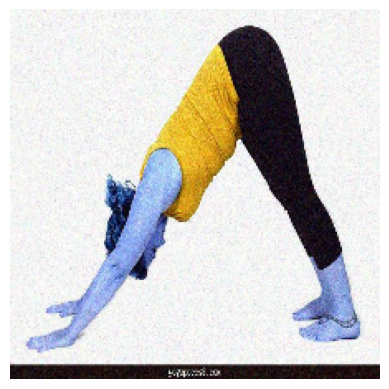

In [ ]:
plt.axis('off')
plt.imshow(X[4])

In [ ]:
predicted = classifier.predict(np.array([x0_resized, x1_resized, x2_resized]))
predicted = np.argmax(predicted, axis=1)
predicted

1/1 [==============================] - 0s 488ms/step


array([550, 550, 592])

In [ ]:

image_labels[550]

'envelope'

In [ ]:
feature_extractor_model = "https://tfhub.dev/google/tf2-preview/mobilenet_v2/feature_vector/4"

pretrained_model_without_top_layer = hub.KerasLayer(
    feature_extractor_model, input_shape=(224, 224, 3), trainable=False)

In [ ]:
num_of_poses = 5

model = tf.keras.Sequential([
  pretrained_model_without_top_layer,
  tf.keras.layers.Dense(num_of_poses)
])

model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_1 (KerasLayer)  (None, 1280)              2257984   
                                                                 
 dense (Dense)               (None, 5)                 6405      
                                                                 
Total params: 2,264,389
Trainable params: 6,405
Non-trainable params: 2,257,984
_________________________________________________________________


In [ ]:
model.compile(
  optimizer="adam",
  loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
  metrics=['acc'])

model.fit(X_train_scaled, y_train, epochs=5)

Epoch 1/5
50/50 [==============================] - 60s 1s/step - loss: 0.8835 - acc: 0.6875
Epoch 2/5
50/50 [==============================] - 55s 1s/step - loss: 0.2899 - acc: 0.9394
Epoch 3/5
50/50 [==============================] - 56s 1s/step - loss: 0.1832 - acc: 0.9631
Epoch 4/5
50/50 [==============================] - 57s 1s/step - loss: 0.1329 - acc: 0.9781
Epoch 5/5
50/50 [==============================] - 57s 1s/step - loss: 0.1037 - acc: 0.9887


In [ ]:
model.evaluate(X_test_scaled,y_test)

17/17 [==============================] - 19s 1s/step - loss: 0.1462 - acc: 0.9700


[0.1462169587612152, 0.9700374603271484]

In [ ]:
model.save('yoga_classifier.h5')

In [ ]:
yoga_pose = Image.open("yy.jpg").resize(IMAGE_SHAPE)
yoga_pose

yoga_pose = np.array(yoga_pose)/255.0
yoga_pose.shap
yoga_pose[np.newaxis, ...]

result = model.predict(yoga_pose[np.newaxis, ...])
result.shape

labs = ['downdog', 'goddess', 'plank', 'tree', 'warror2']
predicted_label_index = np.argmax(result)
print(f"{predicted_label_index}:{labs[predicted_label_index]}")

1/1 [==============================] - 0s 45ms/step
2:plank


In [ ]:
!pip install opencv-python-headless


In [ ]:
from google.colab import output
from IPython.display import display, HTML

def start_video_stream():
    display(("""
        <script>
        const video = document.createElement('video');
        video.setAttribute('width', '640');
        video.setAttribute('height', '480');
        video.setAttribute('autoplay', true);
        document.body.appendChild(video);
        const constraints = {
            video: true
        };
        navigator.mediaDevices.getUserMedia(constraints).then((stream) => {
            video.srcObject = stream;
        }).catch((err) => console.log("Error accessing webcam: " + err));
        </script>
    """))

start_video_stream()


'\n        <script>\n        const video = document.createElement(\'video\');\n        video.setAttribute(\'width\', \'640\');\n        video.setAttribute(\'height\', \'480\');\n        video.setAttribute(\'autoplay\', true);\n        document.body.appendChild(video);\n        const constraints = {\n            video: true\n        };\n        navigator.mediaDevices.getUserMedia(constraints).then((stream) => {\n            video.srcObject = stream;\n        }).catch((err) => console.log("Error accessing webcam: " + err));\n        </script>\n    '

In [ ]:
import numpy as np
import PIL.Image as Image
import tensorflow as tf
import ipywidgets as widgets
from IPython.display import display, HTML, Javascript
import base64
from io import BytesIO

# List of yoga poses for classification
labs = ['downdog', 'goddess', 'plank', 'tree', 'warrior2']

# Define image shape based on your model's input size
IMAGE_SHAPE = (224, 224)

# Load your model (Make sure it's loaded correctly)
# model = ...

# Create a widget to display webcam feed
image_widget = widgets.Image(format='jpeg', width=640, height=480)
display(image_widget)

# JavaScript to start the webcam and capture a frame
def start_video_stream():
    display(("""
        <script>
        const video = document.createElement('video');
        video.setAttribute('width', '640');
        video.setAttribute('height', '480');
        video.setAttribute('autoplay', true);
        document.body.appendChild(video);

        const canvas = document.createElement('canvas');
        canvas.width = 640;
        canvas.height = 480;
        document.body.appendChild(canvas);

        const constraints = {
            video: true
        };

        let stream = null;
        navigator.mediaDevices.getUserMedia(constraints).then(function(mediaStream) {
            video.srcObject = mediaStream;
            stream = mediaStream;
        }).catch((err) => console.log("Error accessing webcam: " + err));

        // Function to capture a frame from video and send back base64 string
        function captureFrame() {
            const ctx = canvas.getContext('2d');
            ctx.drawImage(video, 0, 0, canvas.width, canvas.height);
            const dataUrl = canvas.toDataURL('image/jpeg');
            // Send the captured frame back to Python
            window.frame_data = dataUrl; // Store in global object
        }

        window.captureFrame = captureFrame;
        </script>
    """))

start_video_stream()

# Capture frame and predict pose
def capture_and_predict():
    # Ensure the frame_data is captured
    if 'frame_data' not in globals():
        print("Failed to capture frame")
        return None

    frame_data = globals()['frame_data']

    # Decode the base64 string into bytes
    img_data = base64.b64decode(frame_data.split(",")[1])

    # Convert byte data into image using PIL
    image = Image.open(BytesIO(img_data)).resize(IMAGE_SHAPE)

    # Preprocess the image
    yoga_pose = np.array(image) / 255.0
    yoga_pose = yoga_pose[np.newaxis, ...]

    # Predict the pose using the model
    result = model.predict(yoga_pose)
    predicted_label_index = np.argmax(result)
    predicted_label = labs[predicted_label_index]

    # Convert frame to jpeg and update widget
    _, img_encoded = cv2.imencode('.jpg', yoga_pose[0])
    image_widget.value = img_encoded.tobytes()

    print(f"Predicted Yoga Pose: {predicted_label}")
    return predicted_label

# Button to capture and predict pose manually
capture_button = widgets.Button(description="Capture Frame")
output = widgets.Output()

def on_button_click(b):
    predicted_label = capture_and_predict()
    with output:
        if predicted_label:
            print(f"Predicted Yoga Pose: {predicted_label}")
        else:
            print("Failed to capture a valid frame.")

capture_button.on_click(on_button_click)
display(capture_button, output)


Image(value=b'', format='jpeg', height='480', width='640')

'\n        <script>\n        const video = document.createElement(\'video\');\n        video.setAttribute(\'width\', \'640\');\n        video.setAttribute(\'height\', \'480\');\n        video.setAttribute(\'autoplay\', true);\n        document.body.appendChild(video);\n        \n        const canvas = document.createElement(\'canvas\');\n        canvas.width = 640;\n        canvas.height = 480;\n        document.body.appendChild(canvas);\n        \n        const constraints = {\n            video: true\n        };\n        \n        let stream = null;\n        navigator.mediaDevices.getUserMedia(constraints).then(function(mediaStream) {\n            video.srcObject = mediaStream;\n            stream = mediaStream;\n        }).catch((err) => console.log("Error accessing webcam: " + err));\n        \n        // Function to capture a frame from video and send back base64 string\n        function captureFrame() {\n            const ctx = canvas.getContext(\'2d\');\n            ctx.drawImag

Button(description='Capture Frame', style=ButtonStyle())

Output()